In [2]:
import pandas as pd
import nltk  
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
import re
import numpy as np
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from sklearn.manifold import TSNE
from sklearn.feature_extraction.text import TfidfVectorizer
import xgboost as xgb
import seaborn as sns
import plotly.express as px

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [11]:
train_data = pd.read_csv('/content/drive/My Drive/train.csv')

In [12]:
train_data.head()

,id,qid1,qid2,question1,question2,is_duplicate
0,0,1,2,What is the step by step guide to invest in sh...,What is the step by step guide to invest in sh...,0
1,1,3,4,What is the story of Kohinoor (Koh-i-Noor) Dia...,What would happen if the Indian government sto...,0
2,2,5,6,How can I increase the speed of my internet co...,How can Internet speed be increased by hacking...,0
3,3,7,8,Why am I mentally very lonely? How can I solve...,Find the remainder when [math]23^{24}[/math] i...,0
4,4,9,10,"Which one dissolve in water quikly sugar, salt...",Which fish would survive in salt water?,0


In [13]:
train_data.describe()

,id,qid1,qid2,is_duplicate
count,404290.000000,404290.000000,404290.000000,404290.000000
mean,202144.500000,217243.942418,220955.655337,0.369198
std,116708.614502,157751.700002,159903.182629,0.482588
min,0.000000,1.000000,2.000000,0.000000
25%,101072.250000,74437.500000,74727.000000,0.000000
50%,202144.500000,192182.000000,197052.000000,0.000000
75%,303216.750000,346573.500000,354692.500000,1.000000
max,404289.000000,537932.000000,537933.000000,1.000000


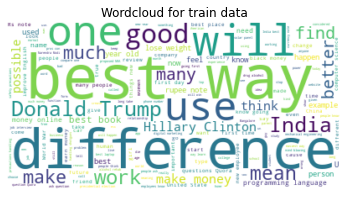

In [53]:
train_text=pd.Series(train_data['question1'].tolist() + train_data['question2'].tolist()).astype(str)
wordcloud = WordCloud( background_color = 'white').generate(" ".join(train_text.astype(str)))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title("Wordcloud for train data")
plt.axis("off")
plt.show()

In [14]:
fig=px.bar(train_data.groupby("is_duplicate").count()["id"],width=500, height=400,title="IS_DUPLICATE REPARTITION".lower())
fig.update_traces(marker_color="#DC143C")
fig.update_layout(title_x=0.5,title_y=0.85)
fig.update_xaxes(type='category')
fig.show()

In [15]:
en_stops = set(stopwords.words('english'))
train_data["clean_q1"]=train_data['question1'].apply(lambda x: str(x).split(" "))
train_data["clean_q1"]=train_data['clean_q1'].apply(lambda x: [word for word in x if word not in en_stops])
train_data["clean_q2"]=train_data['question2'].apply(lambda x: str(x).split(" "))
train_data["clean_q2"]=train_data['clean_q2'].apply(lambda x: [word for word in x if word not in en_stops])

In [28]:
train_data["len_questions"]=train_data['question1'].str.len()+train_data['question2'].str.len()
fig=px.histogram(train_data,x="len_questions",color="is_duplicate",height=400,width=600,title="len_questions")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [27]:
train_data["diff_len_questions"]=train_data['question1'].str.len()-train_data['question2'].str.len()
fig=px.histogram(train_data,x="diff_len_questions",color="is_duplicate",height=400,width=600,title="diff_len_questions")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [33]:
len_train1=train_data['clean_q1'].apply(lambda x: len(x))
len_train2=train_data['clean_q2'].apply(lambda x: len(x))
train_data["nb_words"]=len_train1+len_train2
fig=px.histogram(train_data,x="nb_words",color="is_duplicate",height=400,width=600,title="nb_words")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [34]:
train_data["diff_nb_words"]=len_train1-len_train2
fig=px.histogram(train_data,x="diff_nb_words",color="is_duplicate",height=400,width=600,title="diff_nb_words")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [35]:
def common_words(x):
  return len(set((x["clean_q1"]))&set((x["clean_q2"])))
train_data["nb_common_words"]=train_data.apply(common_words,axis=1)
fig=px.histogram(train_data,x="nb_common_words",color="is_duplicate",height=400,width=600,title="nb_common_words")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [36]:
train_data["ratio_nb_common_words"]=train_data["nb_common_words"]/(len_train1+len_train2)
fig=px.histogram(train_data,x="ratio_nb_common_words",color="is_duplicate",height=400,width=600,title="ratio_nb_common_words")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [39]:
!pip install python-Levenshtein
import Levenshtein
def lev_dist(x):
  return Levenshtein.distance(str(x["question1"]),str(x["question2"]))
train_data["Levenshtein_distance"]=train_data.apply(lev_dist,axis=1)
fig=px.histogram(train_data,x="Levenshtein_distance",color="is_duplicate",height=400,width=600,title="Levenshtein_distance")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()


In [40]:
from difflib import SequenceMatcher
def seqmat(x):
  return SequenceMatcher(None, str(x["question1"]), str(x["question2"])).ratio()
train_data["Sequence Matcher"]=train_data.apply(seqmat,axis=1)
fig=px.histogram(train_data,x="Sequence Matcher",color="is_duplicate",height=400,width=600,title="Sequence Matcher")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [29]:
!pip install thefuzz
from thefuzz import fuzz
from thefuzz import process

In [32]:
def part_rat(x):
  return fuzz.partial_ratio(str(x["question1"]), str(x["question2"]))
train_data["Fuzz Partial Ratio"]=train_data.apply(part_rat,axis=1)
fig=px.histogram(train_data,x="Fuzz Partial Ratio",color="is_duplicate",height=400,width=600,title="Fuzz Partial Ratio")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [43]:
def set_rat(x):
  return fuzz.token_set_ratio(str(x["question1"]), str(x["question2"]))
train_data["Fuzz Set Ratio"]=train_data.apply(set_rat,axis=1)
fig=px.histogram(train_data,x="Fuzz Set Ratio",color="is_duplicate",height=400,width=600,title="Fuzz Set Ratio")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [44]:
def sort_rat(x):
  return fuzz.token_sort_ratio(str(x["question1"]), str(x["question2"]))
train_data["Fuzz Sort Ratio"]=train_data.apply(sort_rat,axis=1)
fig=px.histogram(train_data,x="Fuzz Sort Ratio",color="is_duplicate",height=400,width=600,title="Fuzz Sort Ratio")
fig.update_layout(title_x=0.5,title_y=0.80,font_size=10)
fig.show()

In [51]:
features_train_data=train_data[["is_duplicate","len_questions","Sequence Matcher","Fuzz Partial Ratio","nb_words","diff_nb_words","nb_common_words","ratio_nb_common_words","Levenshtein_distance","Fuzz Set Ratio","Fuzz Sort Ratio"]]

In [57]:
features_train_data.groupby("is_duplicate").mean()

,len_questions,Sequence Matcher,Fuzz Partial Ratio,nb_words,diff_nb_words,nb_common_words,ratio_nb_common_words,Levenshtein_distance,Fuzz Set Ratio,Fuzz Sort Ratio
is_duplicate,,,,,,,,,,
0,127.760681,0.515071,60.334274,14.797665,-0.186710,2.210589,0.163812,46.423716,67.718489,59.24606
1,105.780280,0.689477,72.802382,12.427715,0.001273,3.425712,0.282298,26.278569,82.662227,72.28145


In [58]:
features_train_data

,is_duplicate,len_questions,Sequence Matcher,Fuzz Partial Ratio,nb_words,diff_nb_words,nb_common_words,ratio_nb_common_words,Levenshtein_distance,Fuzz Set Ratio,Fuzz Sort Ratio
0,0,123.0,0.926829,98,15,1,5,0.333333,9,100,93
1,0,139.0,0.647482,73,15,-5,3,0.200000,43,86,63
2,0,132.0,0.454545,53,14,2,2,0.142857,40,66,66
3,0,115.0,0.069565,30,13,3,0,0.000000,54,36,36
4,0,115.0,0.365217,54,17,5,1,0.058824,53,67,47
...,...,...,...,...,...,...,...,...,...,...,...
404285,0,164.0,0.865854,84,16,0,5,0.312500,13,97,88
404286,1,83.0,0.722892,73,8,0,2,0.250000,13,79,69
404287,0,34.0,0.764706,76,5,1,1,0.200000,6,75,75
404288,0,221.0,0.298643,44,27,-7,0,0.000000,94,48,48


In [61]:
features=np.array(features_train_data.drop("is_duplicate",axis=1))

In [64]:
with open('/content/drive/My Drive/features.csv', 'wb') as f:
    np.save(f, features)